# Homework 1 
## QBIO 577
### Feriel Ouerghi

# Question 1

| Biological Entity | Length | Notes |
| --- | --- | --- |
| Atoms | 0.1 nm |  |
| DNA | 2 nm |  |
| Proteins | 10 nm |  |
| Genes | 10-100 nm |  |
| Chromosomes | $10^{2}$ nm |  |
| Virus | $10^{2}$ nm |  |
| Bacteria or Mitochondria | 1 um |  |
| Cellular life or cells in general | $10^{4}$ nm | An example of this is animal cells being 10 um - 100 um or Red blood cells that are around 6 microns|
| Organs | 100 mm | Examples of this are the liver, lungs, brain, and heart |
| Organizm | 1 m | An example of this is the human body |


# Question 2a

Describe the meaning of each term in the first equation $x'_{1}$: 
- The term $a_{1}$ $x_{1}$ is the growth of $x_{1}$ at rate $x_{1}$
- The term 1 - $x_{1}$ - 0.1 * $x_{2}$ - 0.1 * $x_{3}$: this is the crowding factor. This captures the feedback $x_{1}$ gets from other cells including its own self. In this case, since feedback from $x_{2}$ to $x_{1}$, $x_{3}$ to $x_{1}$, and $x_{1}$ to itself is all inhibitory, we have to use -. This captures the loss of of $x_{2}$ at rate 0.1 to inhibit $x_{1}$ and the loss of $x_{3}$ at rate 0.1 to inhibit $x_{1}$. 
- The last term which is $c_{1}$ * $x_{1}$ captures the loss of $x_{1}$ at $c_{1}$ when it transforms to $x_{2}$ or $x_{3}$

## Question 2b 

Creating the model of this system and demonstrating it takes different values in terms of parameters.

## Defining the stem cell model from the homework

In [258]:
## Set up environment (if you need to install packages, run: using Pkg; Pkg.add("Plots"))
using ModelingToolkit, DifferentialEquations
using Plots, Makie, CairoMakie
using Latexify
import SymPy

## Colors used for plots
cc = ["#0072BD" "#D95319" "#EDB120" "#800080" "#FFC0CB"];

In [259]:
using ModelingToolkit

@parameters t a₁ c₁ e₁
@variables x₁(t) x₂(t) x₃(t) x₄(t) x₅(t)

D = Differential(t)
  
eqns = [D(x₁) ~ a₁*x₁*(1 - x₁ - 0.1*x₂ - 0.1*x₃) - c₁*x₁,
        D(x₂) ~ 0.5*c₁*x₁ - e₁*x₂,
        D(x₃) ~ e₁*x₂ - 0.9*x₃,
        D(x₄) ~ 0.5*c₁*x₁ - 0.6*x₄,
        D(x₅) ~ x₄ - 0.1*x₅]

5-element Vector{Equation}:
 Differential(t)(x₁(t)) ~ a₁*(1 - 0.1x₂(t) - 0.1x₃(t) - x₁(t))*x₁(t) - c₁*x₁(t)
 Differential(t)(x₂(t)) ~ 0.5c₁*x₁(t) - e₁*x₂(t)
 Differential(t)(x₃(t)) ~ e₁*x₂(t) - 0.9x₃(t)
 Differential(t)(x₄(t)) ~ 0.5c₁*x₁(t) - 0.6x₄(t)
 Differential(t)(x₅(t)) ~ x₄(t) - 0.1x₅(t)

In [260]:
@named scmodel = ODESystem(eqns,t,[x₁,x₂,x₃,x₄,x₅], [a₁,c₁,e₁])

Model scmodel with 5 equations
States (5):
  x₁(t)
  x₂(t)
  x₃(t)
  x₄(t)
  x₅(t)
Parameters (3):
  a₁
  c₁
  e₁

## Question 2c

# Set up the model and simulate

In [261]:
using DifferentialEquations

## Define the initial conditions and parameters
u0 = [0.4; 0.2; 0.2; 0; 0]
tspan = (0.0,50.0) 
p = [0.9,0.1,0.5]

prob = ODEProblem(scmodel, u0, tspan, p) 
sol = solve(prob, Tsit5(), saveat=0.01)


retcode: Success
Interpolation: 1st order linear
t: 5001-element Vector{Float64}:
  0.0
  0.01
  0.02
  0.03
  0.04
  0.05
  0.06
  0.07
  0.08
  0.09
  0.1
  0.11
  0.12
  ⋮
 49.89
 49.9
 49.91
 49.92
 49.93
 49.94
 49.95
 49.96
 49.97
 49.98
 49.99
 50.0
u: 5001-element Vector{Vector{Float64}}:
 [0.4, 0.2, 0.2, 0.0, 0.0]
 [0.4016166360718703, 0.19920240010408377, 0.1992015992046, 0.00019980449771581205, 9.990145167254765e-7]
 [0.403234514426726, 0.19840958486681995, 0.19840639360617848, 0.0003992199674623716, 3.992129930970756e-6]
 [0.4048535901720803, 0.19762153103352845, 0.1976143783337437, 0.0005982493443442445, 8.973479851958107e-6]
 [0.40647381828030743, 0.19683821544231958, 0.1968255484460913, 0.0007968955237405108, 1.5937232306402163e-5]
 [0.408095153588643, 0.19605961502409391, 0.19603989893180432, 0.000995161361304763, 2.4877589738509897e-5]
 [0.4097175507991836, 0.19528570680254229, 0.19525742470925325, 0.001193049672965095, 3.578878900997987e-5]
 [0.4113409645382221, 0.194

In [262]:
## Access the solution with 
sol.t    # vector of time points
sol.u    # array of values for model variables over time 
sol[1,:] # vector of values for variable 1 (x₁) ove time 


5001-element Vector{Float64}:
 0.4
 0.4016166360718703
 0.403234514426726
 0.4048535901720803
 0.40647381828030743
 0.408095153588643
 0.4097175507991836
 0.4113409645382221
 0.41296534943898944
 0.4145906597090937
 0.41621684945156306
 0.4178438727040537
 0.41947168343884994
 ⋮
 0.8752706124335328
 0.8752706257745902
 0.8752706401050457
 0.8752706554524246
 0.875270671844432
 0.8752706893089527
 0.875270707874051
 0.8752707275679711
 0.8752707484191367
 0.875270770456151
 0.8752707937077971
 0.8752708182030378

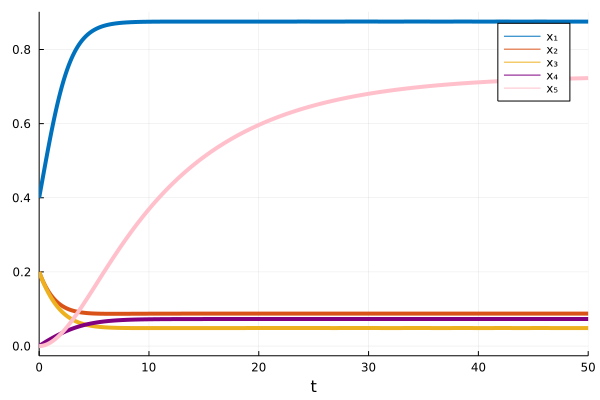

In [263]:
cc = ["#0072BD" "#D95319" "#EDB120" "#800080" "#FFC0CB"];
Plots.plot(sol, lw=4, lc=cc, label=["x₁" "x₂" "x₃" "x₄" "x₅"]) 

For question 2c, the species that dominates as the system reaches steady state is the species $x_{1}$ 

## For question 3: 

Can this system be solved analytically so in terms of $a_{1}$ $c_{1}$ $e_{1}$ ? Why?

Answer: We can solve this system at steady state analytically/symbolically in terms of $a_{1}$ $c_{1}$ $e_{1}$ because solving the problem consists of creating the vector F that contains the right hand side of the differential equations and setting those values to 0. We can write the vector F in terms of the symbols $a_{1}$ $c_{1}$ $e_{1}$. 

What we couldn't do is find out if the fixed point is stable or not because it requires knowing if the eigenvalues of the Jacobian have negative real part. For this reason, we need to know the signs and values of $a_{1}$ $c_{1}$ $e_{1}$. 

## Solving the system at steady state analytically

In [264]:
import SymPy

x₁,x₂,x₃,x₄,x₅ = SymPy.@vars x₁ x₂ x₃ x₄ x₅ 
a₁,c₁,e₁ = SymPy.@vars a₁ c₁ e₁ 

rhs = [a₁*x₁*(1 - x₁ - 0.1*x₂ - 0.1*x₃) - c₁*x₁,
       0.5*c₁*x₁ - e₁*x₂,
       e₁*x₂ - 0.9*x₃,
       0.5*c₁*x₁ - 0.6*x₄,
       x₄ - 0.1 * x₅]

5-element Vector{SymPy.Sym}:
 a₁⋅x₁⋅(-x₁ - 0.1⋅x₂ - 0.1⋅x₃ + 1) - c₁⋅x₁
                         0.5⋅c₁⋅x₁ - e₁⋅x₂
                            e₁⋅x₂ - 0.9⋅x₃
                        0.5⋅c₁⋅x₁ - 0.6⋅x₄
                               x₄ - 0.1⋅x₅

In [265]:
fps = SymPy.solve(rhs, [x₁,x₂,x₃,x₄,x₅])

2-element Vector{NTuple{5, SymPy.Sym}}:
 (0.0, 0.0, 0.0, 0.0, 0.0)
 (180.0*e₁*(a₁ - c₁)/(a₁*(10.0*c₁*e₁ + 9.0*c₁ + 180.0*e₁)), 90.0*c₁*(a₁ - c₁)/(a₁*(10.0*c₁*e₁ + 9.0*c₁ + 180.0*e₁)), 100.0*c₁*e₁*(a₁ - c₁)/(a₁*(10.0*c₁*e₁ + 9.0*c₁ + 180.0*e₁)), 150.0*c₁*e₁*(a₁ - c₁)/(a₁*(10.0*c₁*e₁ + 9.0*c₁ + 180.0*e₁)), 1500.0*c₁*e₁*(a₁ - c₁)/(a₁*(10.0*c₁*e₁ + 9.0*c₁ + 180.0*e₁)))

In [266]:
## Calculate the Jacobian 
jac = rhs.jacobian([x₁,x₂,x₃,x₄,x₅])


5×5 Matrix{SymPy.Sym}:
 -a₁⋅x₁ + a₁⋅(-x₁ - 0.1⋅x₂ - 0.1⋅x₃ + 1) - c₁  …                   0
                                       0.5⋅c₁                      0
                                            0                      0
                                       0.5⋅c₁                      0
                                            0     -0.100000000000000

## The rest of question 3: 
- This model permits 2 fixed points and the coordinates of those two fixed points are stored in fps which is a 2-element vector. One of those two fixed points is (0,0,0)
- To ensure that $x_{1}$ reaches a positive value at steady state: first, we need $a_{1}$ to be larger than 0. Second, $a_{1}$ and $c_{1}$ cannot be equal. In fact, $a_{1}$ to be larger than $c_{1}$. This is because if $a_{1}$ is smaller than $c_{1}$, than if we expand the $x'_{1}$ equation, all the terms will be negative so $x_{1}$ will not have a positive value at steady state. 

# Question 4: Can more than one steady state be reached?

## We need to simulate the model for at least 20 sets of initial conditions

First we are going to generate a matrix with 20 rows (each row represents a set of initial conditions) and 5 columns (each column represents the values of $x_{1}$,$x_{2}$,$x_{3}$,$x_{4}$, and $x_{5}$)

In [351]:
#Defining the random number matrix
#import Pkg; 
#Pkg.add("Distributions")
using Distributions
r = rand(Uniform(0,1), (20, 5))

20×5 Matrix{Float64}:
 0.810523   0.246214   0.155612    0.0756605  0.333413
 0.510206   0.555506   0.316671    0.251159   0.13292
 0.428968   0.0143467  0.614743    0.975141   0.6541
 0.441364   0.896123   0.603778    0.935853   0.679839
 0.200559   0.298782   0.370333    0.658236   0.841265
 0.606012   0.470678   0.719344    0.61611    0.207027
 0.594971   0.771699   0.650165    0.400235   0.926652
 0.623301   0.186718   0.190339    0.177579   0.118376
 0.927453   0.477117   0.145356    0.716296   0.353065
 0.0153767  0.21235    0.693698    0.289197   0.601611
 0.883813   0.433079   0.652991    0.0729741  0.343742
 0.17382    0.522066   0.482222    0.762338   0.434538
 0.177353   0.319615   0.672698    0.662558   0.908373
 0.220022   0.987203   0.592142    0.912368   0.836494
 0.925981   0.137808   0.116583    0.815357   0.453615
 0.456677   0.0118296  0.314053    0.131876   0.915252
 0.95398    0.213969   0.00507159  0.603038   0.575569
 0.135325   0.592566   0.453516    0.822898   

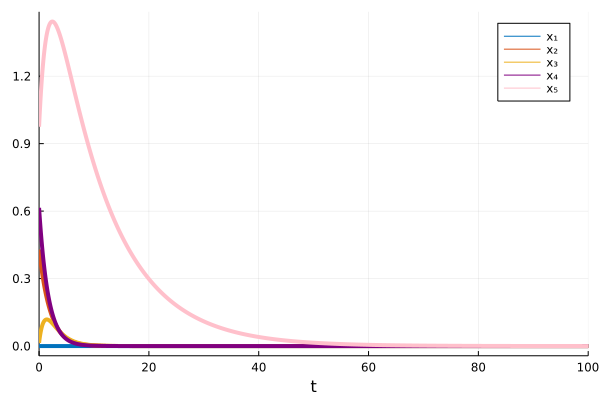

In [354]:
#Solving it with x₁=0
using DifferentialEquations
x=r[3,:]
u0=[0,x[1],x[2],x[3],x[4]]
tspan = (0.0,100.0) 
p = [0.9,0.1,0.5]
prob = ODEProblem(scmodel, u0, tspan, p) 
sol = solve(prob, Tsit5(), saveat=0.01)
#how do we save this solution in an array?? because we will have 20 solution objects by the end
## Access the solution with 
sol.t    # vector of time points
sol.u    # array of values for model variables over time 
sol[1,:] # vector of values for variable 1 (x₁) ove time 
cc = ["#0072BD" "#D95319" "#EDB120" "#800080" "#FFC0CB"];
display(Plots.plot(sol, lw=4, lc=cc, label=["x₁" "x₂" "x₃" "x₄" "x₅"])) 


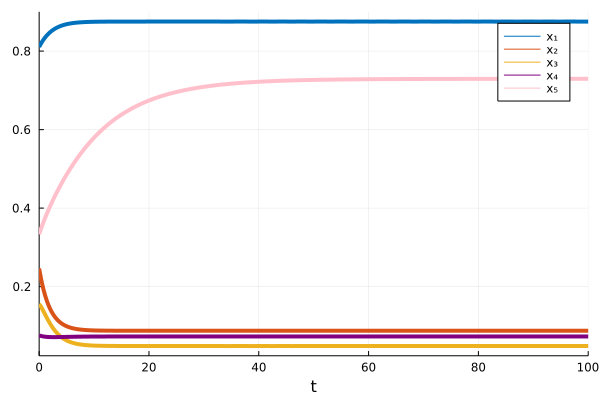

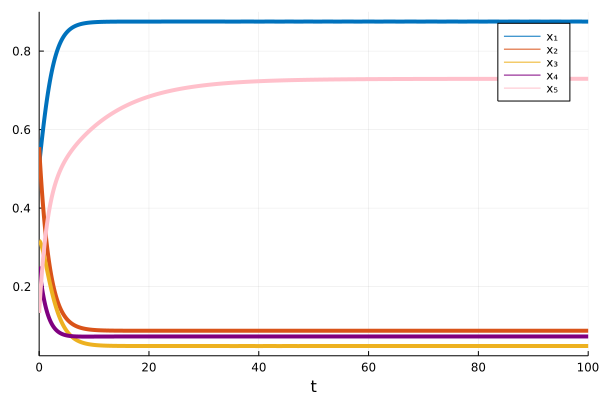

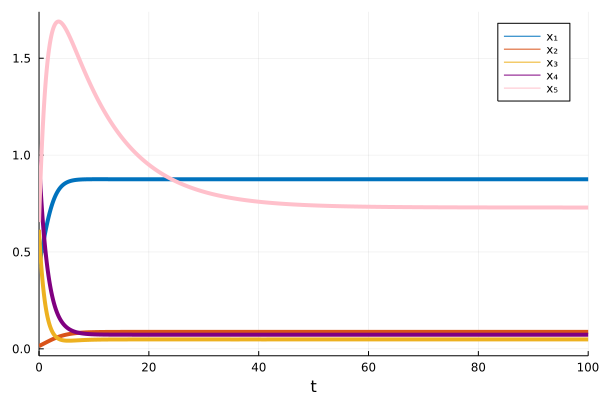

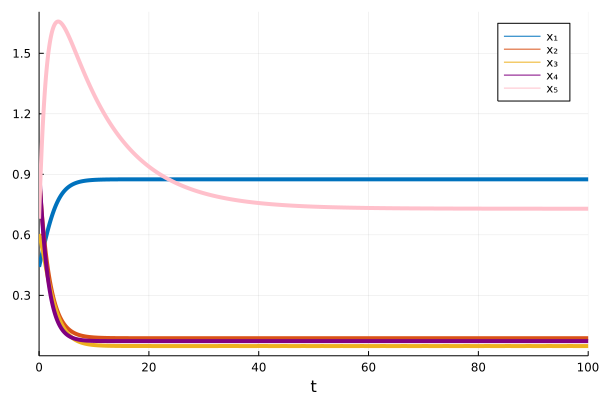

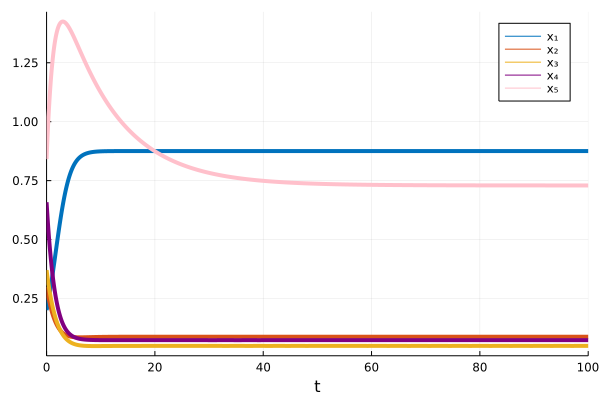

...

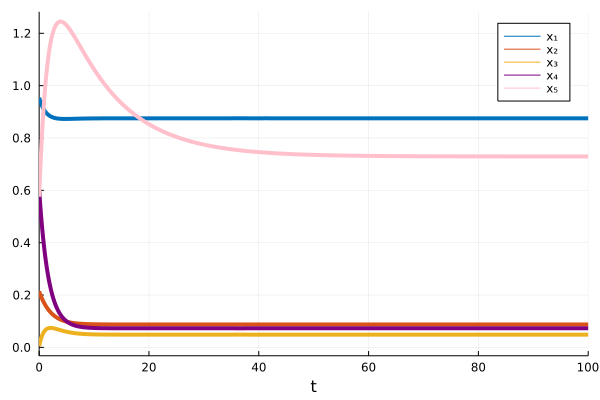

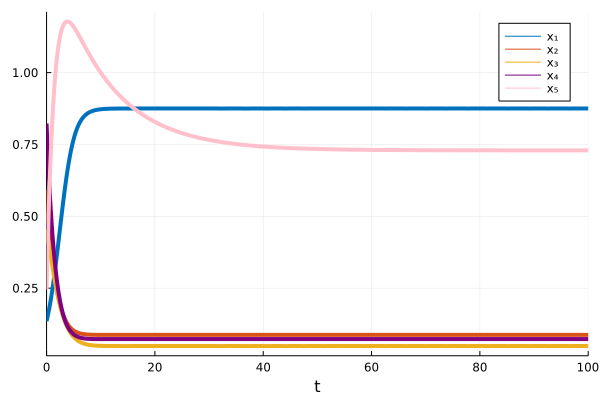

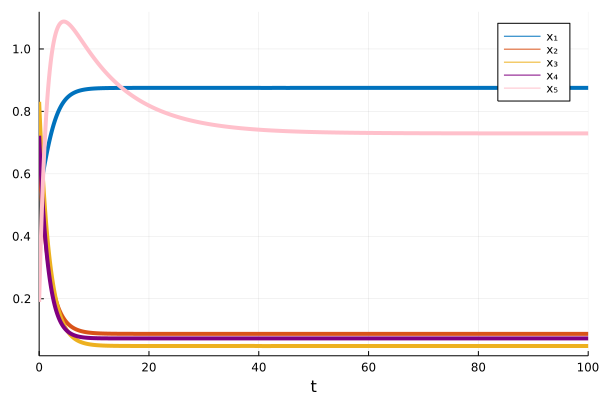

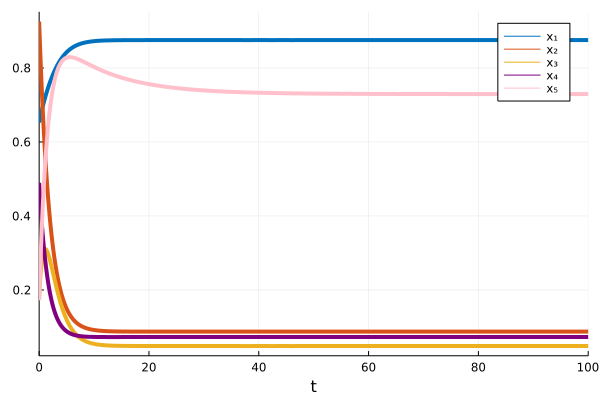

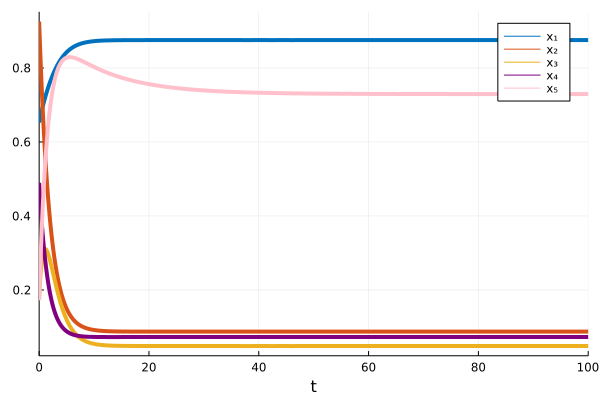

In [355]:
using DifferentialEquations

## Define the initial conditions and parameters

for i = 1:20
    x=r[i,:]
    u0=[x[1],x[2],x[3],x[4],x[5]]
    tspan = (0.0,100.0) 
    p = [0.9,0.1,0.5]
    prob = ODEProblem(scmodel, u0, tspan, p) 
    sol = solve(prob, Tsit5(), saveat=0.01)
    #how do we save this solution in an array?? because we will have 20 solution objects by the end
    ## Access the solution with 
    sol.t    # vector of time points
    sol.u    # array of values for model variables over time 
    sol[1,:] # vector of values for variable 1 (x₁) ove time 
    cc = ["#0072BD" "#D95319" "#EDB120" "#800080" "#FFC0CB"];
    display(Plots.plot(sol, lw=4, lc=cc, label=["x₁" "x₂" "x₃" "x₄" "x₅"])) 
end 
current()
##To plot, I may want to take all the x1 from all the solutions and plot them

## Question 4: Is there evidence for multistability?

- There is evidence for multistability because there are two scenarios: 
    
    1) the first when $x_{1}$ is not equal to 0 and we see the same pattern across all plots. (what see in the 20 plots above)
   
   2) the second when $x_{1}$ is equal to 0 and we see that there is a second stable state where since $x_{1}$ reaches the end. (what we see in the first plot)


- A critical initial threshold would be for $x_{1}$ to not start at 0. Because all the other cell types ($x_{2}$, $x_{3}$, $x_{4}$, and $x_{5}$) depend on how much of $x_{1}$ we have. If $x_{1}$ is 0. 
- What alternative strategies could be used to investigate whether this model permits multistability? To determine whether a model permits multistability, is to solve the equations and finding the fixed points. If there are two or more stable points, then we can confirm that this model permits multistability (i.e. allows multiple steady states.)

# Question 5 

Let's choose the coherent type-1 feedforwad loop (C1-FFL) as a network motif to work on. An example of a biological system that follows this motif mentioned in the paper is in the arabinose utilization system of E. coli. In this system, after receiving signaling from cAMP, the transcription factor CRP, which regulates both the arabinose regulator AraC and the araBAD promoter, is activated. This triggers the activation of the arabinose regulator AraC which also regulates araBAD. Since the promoter araBAD is regulated by both these transcription factors, once CRP and AraC are activated, araBAD is also activated. 

The system can be represented by the following set of differential equations:

In [358]:
using ModelingToolkit

@parameters t a₁ a₂ a₃ a₄
@variables x₁(t) x₂(t) x₃(t) 

D = Differential(t)
  
eqns = [D(x₁) ~ a₁*x₁ - a₂*x₁,
        D(x₂) ~ 0.5*a₂*x₁ - a₃ * x₂,
        D(x₃) ~ 0.5*a₂*x₁ + a₃ * x₂ - a₄*x₃]

@named scmodel = ODESystem(eqns,t,[x₁,x₂,x₃], [a₁,a₂,a₃,a₄])

Model scmodel with 3 equations
States (3):
  x₁(t)
  x₂(t)
  x₃(t)
Parameters (4):
  a₁
  a₂
  a₃
  a₄

What does each equation represent?
- $x_{1}$ represents CRP. The equation of $x'_{1}$ represents the initial $x_{1}$ at growth rate $a_{1}$ and accounting for the loss of the population $x_{1}$ at $a_{2}$
- $x_{2}$ represents AraC. The equation of $x'_{2}$ represents population we start with which is half of $a_{2}$*$x_{1}$ since the regulator CRP splits in half (one half activating araBAD and the other directed towards AraC). We subtract the loss of $x_{2}$ at rate $a_{3}$.
- $x_{3}$ represents the promoter araBAD. The equation $x'_{3}$ represents the population we start with which is half of $a_{2}$*$x_{1}$ since the regulator CRP splits in half (one half activating araBAD and the other directed towards AraC) and the population from $x_{2}$ at rate $a_{3}$. We subtract the loss of $x_{3}$ at rate $a_{4}$.

### Let's choose a set of initial conditions and parameters and simulate the model

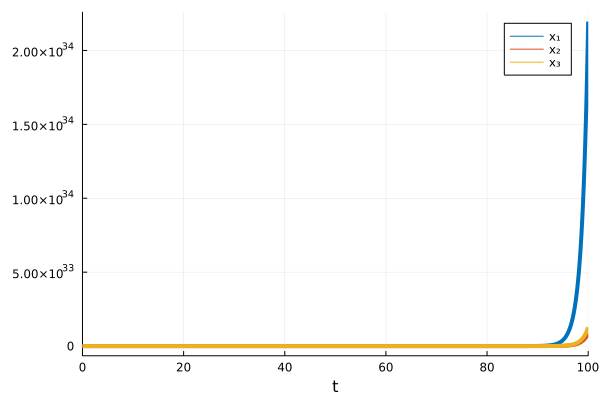

In [359]:
using DifferentialEquations

## Define the initial conditions and parameters
u0 = [0.4; 0.2; 0.2]
tspan = (0.0,100.0) 
p = [0.9,0.1,0.5,0.4]


prob = ODEProblem(scmodel, u0, tspan, p) 
sol = solve(prob, Tsit5(), saveat=0.01)

cc = ["#0072BD" "#D95319" "#EDB120"];
Plots.plot(sol, lw=4, lc=cc, label=["x₁" "x₂" "x₃"]) 

Let's choose a set of different parameters using random function to generate different values of the four parameters

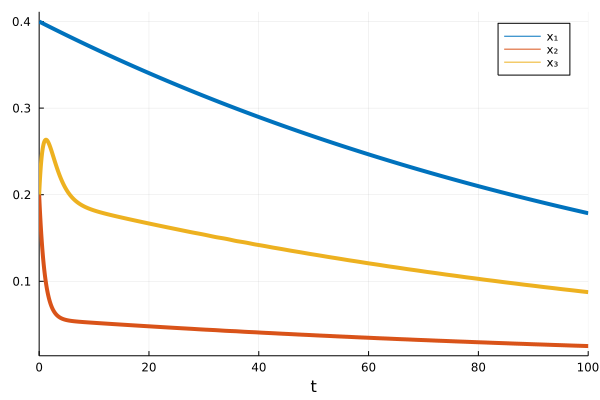

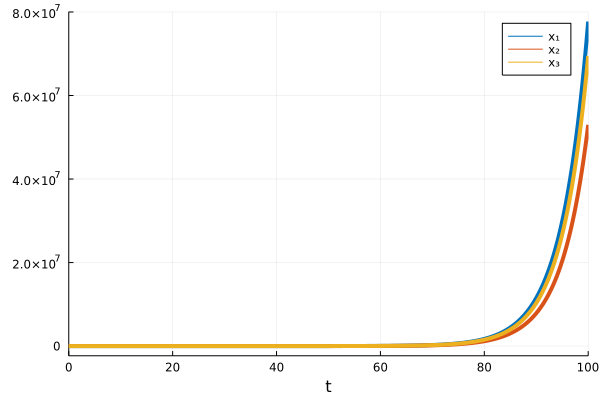

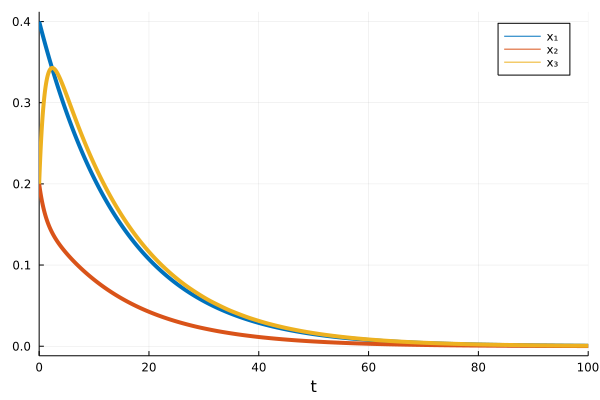

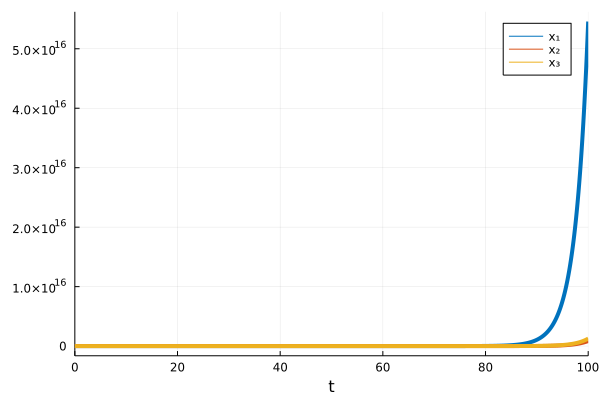

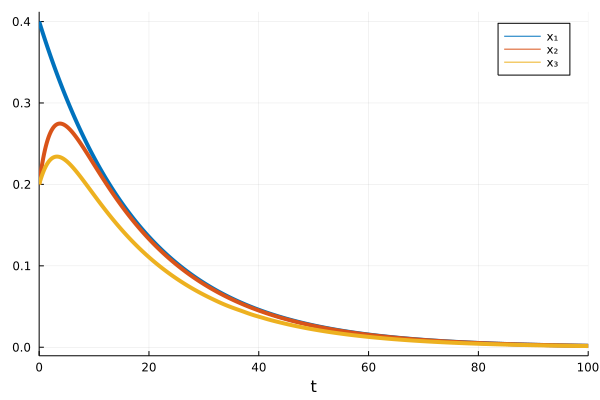

...

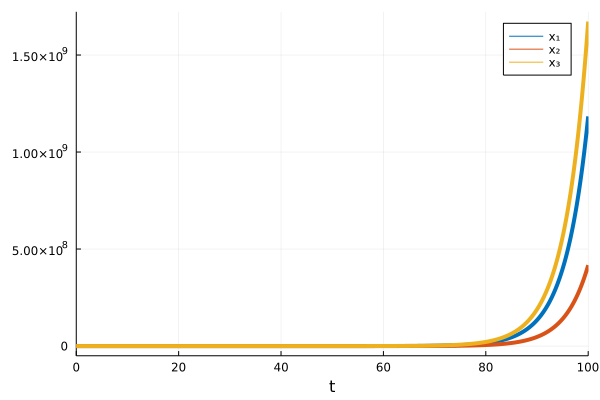

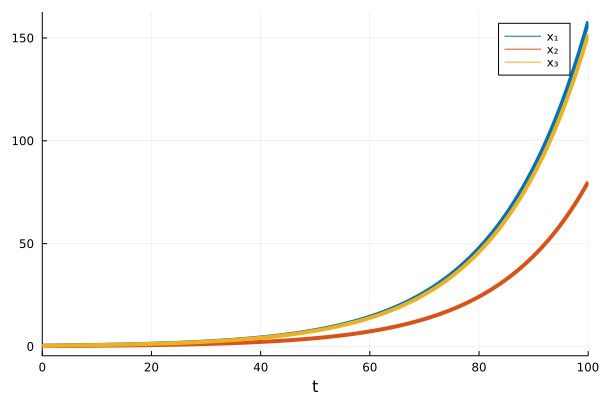

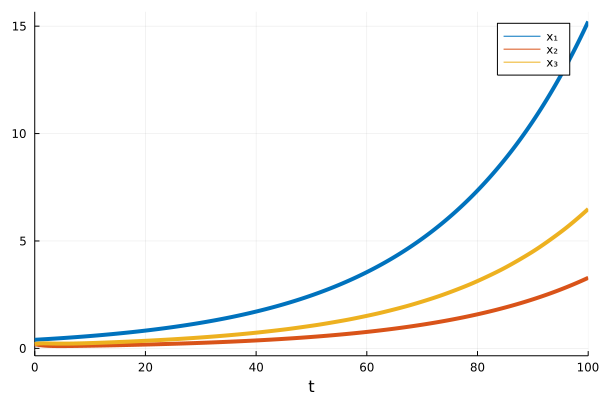

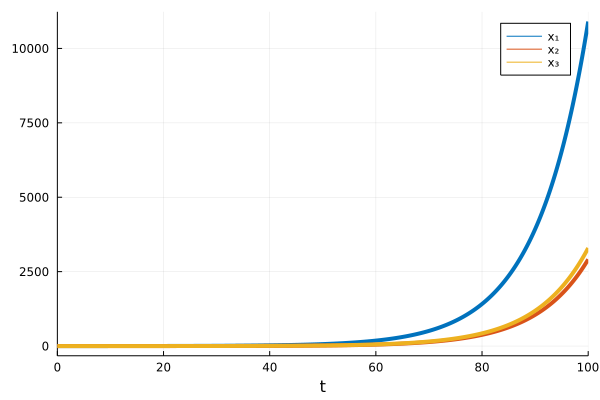

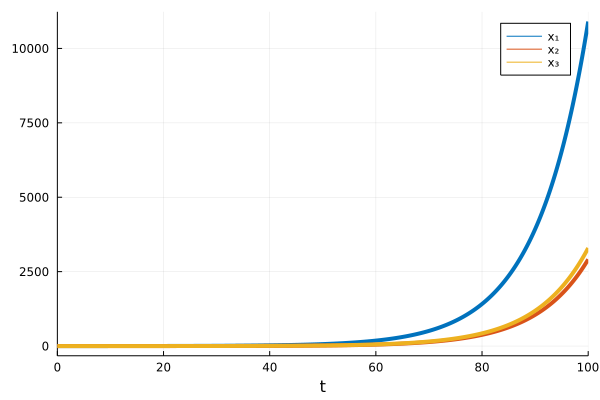

In [364]:
#Defining the random number matrix
using Distributions
r = rand(Uniform(0,1), (20, 4))

using DifferentialEquations

## Define the initial conditions and parameters

for i = 1:20
    x=r[i,:]
    u0 = [0.4; 0.2; 0.2]
    tspan = (0.0,100.0) 
    p = [x[1],x[2],x[3],x[4]]
    prob = ODEProblem(scmodel, u0, tspan, p) 
    sol = solve(prob, Tsit5(), saveat=0.01)
    #how do we save this solution in an array?? because we will have 20 solution objects by the end
    ## Access the solution with 
    sol.t    # vector of time points
    sol.u    # array of values for model variables over time 
    sol[1,:] # vector of values for variable 1 (x₁) ove time 
    cc = ["#0072BD" "#D95319" "#EDB120" "#800080" "#FFC0CB"];
    display(Plots.plot(sol, lw=4, lc=cc, label=["x₁" "x₂" "x₃"])) 
end 
current()
##To plot, I may want to take all the x1 from all the solutions and plot them

1. Discuss the behavior of the model as we change the parameters and what type of transient and equilibria behaviors does this model display?
- As we simulate across a range of different parameters, we see that there are two patterns:

    a. The first is that we reach a steady state where all the populations values reach 0 at the end. This happens in case where $a_{1}$ and $a_{2}$ are almost the same value for example (so growth and loss are the same)    
    b. The second is that we reach an exponential state of growth (we don't reach a steady state). This happens when $a_{4}$ is low for example.
    
In conclusion, the model depending on the values of the parameters goes to either one of these states:
- The first being a steady state where all the populations do not dominate and reach 0. 
- The second being a state where they continue in exponential growth

In [366]:
import SymPy

x₁,x₂,x₃ = SymPy.@vars x₁ x₂ x₃ 
a₁,a₂,a₃,a₄ = SymPy.@vars a₁ a₂ a₃ a₄

rhs = [a₁*x₁ - a₂*x₁,
       0.5*a₂*x₁ - a₃ * x₂,
       0.5*a₂*x₁ + a₃ * x₂ - a₄*x₃]

3-element Vector{SymPy.Sym}:
             a₁⋅x₁ - a₂⋅x₁
         0.5⋅a₂⋅x₁ - a₃⋅x₂
 0.5⋅a₂⋅x₁ + a₃⋅x₂ - a₄⋅x₃

In [367]:
fps = SymPy.solve(rhs, [x₁,x₂,x₃])

Dict{Any, Any} with 3 entries:
  x₁ => 0.0
  x₂ => 0.0
  x₃ => 0.0

In [368]:
## Calculate the Jacobian 
jac = rhs.jacobian([x₁,x₂,x₃])

3×3 Matrix{SymPy.Sym}:
 a₁ - a₂    0    0
  0.5⋅a₂  -a₃    0
  0.5⋅a₂   a₃  -a₄

In [374]:
## Substitute parameter values 
p = [0.9,0.9,0.4,0.01];

jac_eval = jac.subs([(a₁,p[1]),(a₂,p[2]),(a₃,p[3]),(a₄,p[4])])


3×3 Matrix{SymPy.Sym}:
                 0                   0                    0
 0.450000000000000  -0.400000000000000                    0
 0.450000000000000   0.400000000000000  -0.0100000000000000

In [375]:
## Calculate eigenvalues 
eigs = jac_eval.eigenvals()


Dict{Any, Any} with 3 entries:
  -0.400000000000000022204460492503130808472633361816406249999999999696141… => 1
  -0.010000000000000000208166817117216851329430937767028808593750000002373… => 1
  -2.373697007538662056413743100349007740061746314093675946065781411496965… => 1

In [376]:
## Find the stability of the fixed point 
is_stable = false
if maximum(real(collect(keys(eigs)))) < 0
    is_stable = true
end

is_stable

true